# What's the best place to rent in-and-around Shoreditch?

Analysis By: Alex Wilson

## 1. Introduction

## 1.1 Background

Shoreditch has a rich and varied background, in the 1600s it was known for theatre & entertainment, in the 1700 & 1800s it was known for textile manufacturing, and throughout the 1900s depsite its proximity to the City of London it was left neglected and had a generally poor reputation. Around the 1990s after development in the area, however, it it started to become a much more popular area. 

Today it symbolises gentrification and much of East London, with plenty of venues and establishments popular with millennials — including the controversial Cereal Killer Cafe.  It's a melting pot of culture and the birthplace of many start-ups, however especially recently housing prices in Shoreditch have begun to climb as bankers in the city have begun to move in, and as ever-fancier property developments are built.

## 1.2 Problem

Data surrounding the amenities in Shoreditch is freely available, and can be used to try and identify an "optimal" place to move.

The purpose of this project is to identify the best area in & surrounding Shoreditch to rent, balancing transport options & rental rates.

## 1.3 Interest

This will be of interest to both people looking to move to a more trendy area of London ahead of the increasing rates of rent, and to aspiring property developers looking for a safer bet on a property development.

# 2. Data

## 2.1 Data sources

Data surrounding the features (including transport hubs) of each London borough are available via geo-data providers such as [Foursquare](https://www.foursquare.com/), rental pricing is aggregated monthly per ward, and made available yearly via the [Office of National Statistics](https://www.ons.gov.uk/peoplepopulationandcommunity/housing/datasets/privaterentalmarketsummarystatisticsinengland), and GIS data for London is made available via Greater London Authority [here](https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london).

The ONS rental data will be joined to the GIS dataset.  The features of each ward/borough will be retrieved via Foursquare and we will attempt to find similar clusters of wards.

# 3. Methodology

## 3.1 Data Cleaning & Exploratory Data Analysis

We begin by downloading data from our three sources.

In [1]:
%%capture

!pip install folium
!pip install descartes
!pip install geopandas

In [2]:
%%capture

import pandas as pd
import geopandas as gpd
import numpy as np
import folium
import descartes
import requests
from pandas.io.json import json_normalize
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors
import branca

### Parsing the GIS data from the Greater London Authority

The data was downloaded into a Geopandas Dataframe, and we can see it works fairly well after plotting it.

In [3]:
# Firstly, retrieve the GIS data from the Greater London Authority
!wget https://data.london.gov.uk/download/statistical-gis-boundary-files-london/08d31995-dd27-423c-a987-57fe8e952990/London-wards-2018.zip -O London-wards-2018.zip --no-clobber --quiet
london_map = gpd.read_file("zip://London-wards-2018.zip!London-wards-2018_ESRI/London_Ward.shp")
london_map = london_map.to_crs("EPSG:3395")
london_map.plot()

### Parsing the ONS Private rental market summary statistics in England data-set

After a bit of exploratory data-analysis, the first few rows of the data-set have been skipped as it contains a lot of superflouous data.

We are using only rents for 1-bed apartments as it is a fair sample of the wider data-set.

In addition we have skipped the LA code & a further blank column, and are using the Area Code field as the index.

We are only parsing the first 371 records, as again, after this in the data-set the remainder of the Excel file is used for formatting and caveats.

In [12]:
# The code was removed by Watson Studio for sharing.

In [13]:
df = pd.read_excel(streaming_body_1, sheet_name="Table 2.3", skiprows=5, header=1, index_col=2, nrows=371)
df.drop(columns=['LA Code1', 'Unnamed: 0'], inplace=True)
df.index.names = ['Area Code']
print(df.shape)
df.head(5)

(371, 6)


,Area,Count of rents,Mean,Lower quartile,Median,Upper quartile
Area Code,,,,,,
E92000001,ENGLAND,91180,701,490,625,800
E12000001,NORTH EAST,2250,434,350,400,475
E06000047,County Durham UA,280,378,325,350,400
E06000005,Darlington UA,280,377,333,350,403
E06000001,Hartlepool UA,110,379,350,368,405


,NAME,GSS_CODE,DISTRICT,HECTARES,NONLD_AREA,geometry,Area,Count of rents,Mean,Lower quartile,Median,Upper quartile
E09000001,Castle Baynard,E05009297,City and County of the City of London,35.639,6.686,"POLYGON ((-11655.397 6678295.938, -11653.411 6...",City of London,10,1906,1614,1717,2082
E09000001,Farringdon Without,E05009305,City and County of the City of London,32.996,2.271,"POLYGON ((-12408.099 6678500.372, -12420.400 6...",City of London,10,1906,1614,1717,2082
E09000001,Farringdon Within,E05009304,City and County of the City of London,24.375,0.000,"POLYGON ((-10867.467 6680509.789, -10830.327 6...",City of London,10,1906,1614,1717,2082
E09000001,Cripplegate,E05009302,City and County of the City of London,12.717,0.000,"POLYGON ((-10154.660 6679981.937, -10363.071 6...",City of London,10,1906,1614,1717,2082
E09000001,Langbourn,E05009306,City and County of the City of London,5.193,0.000,"POLYGON ((-9246.593 6678820.521, -9329.785 667...",City of London,10,1906,1614,1717,2082


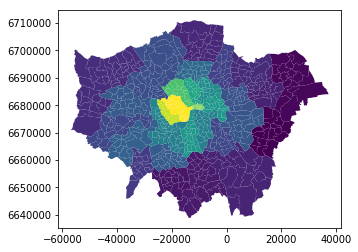

In [14]:
## Merging the ONS Rental & London GIS data
london_map.head()
london_rental_map = london_map.set_index(['LAGSSCODE']).join(df)
london_rental_map.plot(column='Mean')
london_rental_map.head()

Finally, we will attempt to chart our data onto a new interactive Choropleth map, to make it a bit more navigable.

In [15]:
m = folium.Map(location=[51.509865, -0.118092], zoom_start=12)
choropleth = folium.Choropleth(
 geo_data=london_rental_map,
 name='choropleth',
 data=london_rental_map,
 columns=['GSS_CODE', 'Mean'],
 key_on='feature.properties.GSS_CODE',
 fill_color='YlOrRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='London Rents',
 smooth_factor=0
).add_to(m)
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['Mean', 'NAME', 'DISTRICT'],labels=True)
)

folium.LayerControl().add_to(m)
m

## Gathering feature data for each ward
Now that we have successfully created a dataframe of London ward/rental data, and have been able to visualise it with an interactive choropleth map, we will attempt to retrieve feature data from Foursquare for each ward.

In [16]:
# The code was removed by Watson Studio for sharing.

In [17]:
# Get venues and group them by categories
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

def getNearbyVenues(names, latitudes, longitudes, radius=1000, limit=1000):
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            limit)
 
        response = requests.get(url).json()["response"]
        if ("groups" in response):
            results = response['groups'][0]['items']
            venues_list.append([(
                name, 
                lat, 
                lng, 
                v['venue']['name'], 
                v['venue']['location']['lat'], 
                v['venue']['location']['lng'],  
                v['venue']['categories'][0]['name']) for v in results])
        else:
            print("Error with", name)

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['NAME', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)


In [18]:
london_venues = getNearbyVenues(
     names=london_rental_map['NAME'],
     latitudes=london_rental_map['geometry'].to_crs("EPSG:4326").centroid.map(lambda p: p.y),
     longitudes=london_rental_map['geometry'].to_crs("EPSG:4326").centroid.map(lambda p: p.x)
)
london_venues.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  app.launch_new_instance()
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.



Error with Greenford Green
Error with Ealing Common
Error with Chase
Error with Turkey Street
Error with Greenwich West
Error with Beverley
Error with St. Mark's
Error with Ferndale
Error with Chaucer
Error with Worcester Park
Error with Sutton North
Error with Canary Wharf
Error with Bethnal Green
Error with Mile End


,NAME,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Castle Baynard,51.512754,-0.104723,Alchemy,51.513466,-0.102687,Coffee Shop
1,Castle Baynard,51.512754,-0.104723,City of London Distillery,51.513988,-0.104885,Distillery
2,Castle Baynard,51.512754,-0.104723,Pilpel,51.514420,-0.107225,Falafel Restaurant
3,Castle Baynard,51.512754,-0.104723,Apex Temple Court Hotel,51.513738,-0.108878,Hotel
4,Castle Baynard,51.512754,-0.104723,Humble Grape,51.513483,-0.105658,Wine Bar


### Feature Data
Each area has been sampled based on all foursquare venues within a 1km radius of its center. There is likely some overlap here, but that's okay as that is still within a walkable distance, and some of the most important areas for this survey are bigger than that (e.g. Hoxton West is 4.3km^2).

In [19]:
london_venues.groupby('NAME').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
NAME,,,,,,
Abbey,121,121,121,121,121,121
Abbey Road,100,100,100,100,100,100
Abbey Wood,10,10,10,10,10,10
Abingdon,100,100,100,100,100,100
Acton Central,41,41,41,41,41,41
Addiscombe East,19,19,19,19,19,19
Addiscombe West,39,39,39,39,39,39
Addison,100,100,100,100,100,100
Aldborough,4,4,4,4,4,4


### Feature normalisation
We now normalise all venues found so that we can start clustering based on the most popular areas.

In [20]:
london_onehot = pd.get_dummies(london_venues[['Venue Category']], prefix="", prefix_sep="")
london_onehot['NAME'] = london_venues['NAME'] 

fixed_columns = [london_onehot.columns[-1]] + list(london_onehot.columns[:-1])
london_onehot = london_onehot[fixed_columns]

london_grouped = london_onehot.groupby('NAME').mean().reset_index()
london_grouped

,NAME,ATM,Accessories Store,Acupuncturist,Adult Boutique,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,...,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Xinjiang Restaurant,Yakitori Restaurant,Yoga Studio,Zoo,Zoo Exhibit
0,Abbey,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
1,Abbey Road,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.01,0.010000,0.0,0.00,0.000000,0.0,0.0,0.010000,0.0,0.0
2,Abbey Wood,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
3,Abingdon,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
4,Acton Central,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.024390,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
5,Addiscombe East,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
6,Addiscombe West,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
7,Addison,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.01,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
8,Aldborough,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0
9,Aldersgate,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.0,0.0,...,0.03,0.000000,0.0,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0


In [22]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['NAME']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['NAME'] = london_grouped['NAME']

for ind in np.arange(london_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(london_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

# set number of clusters
kclusters = 15

london_grouped_clustering = london_grouped.drop('NAME', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(london_grouped_clustering)

# check cluster labels generated for each row in the dataframe
print(kmeans.labels_[0:10])

# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

london_merged = london_rental_map
london_merged = london_merged.join(neighborhoods_venues_sorted.set_index('NAME'), on='NAME').dropna(axis='rows')

london_merged.head()


[ 9  2  0 10  9  6  2 10  7  5]


,NAME,GSS_CODE,DISTRICT,HECTARES,NONLD_AREA,geometry,Area,Count of rents,Mean,Lower quartile,...,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
E09000001,Castle Baynard,E05009297,City and County of the City of London,35.639,6.686,"POLYGON ((-11655.397 6678295.938, -11653.411 6...",City of London,10,1906,1614,...,Grocery Store,Art Museum,History Museum,Modern European Restaurant,Garden,Event Space,Café,Vietnamese Restaurant,Wine Bar,Roof Deck
E09000001,Farringdon Without,E05009305,City and County of the City of London,32.996,2.271,"POLYGON ((-12408.099 6678500.372, -12420.400 6...",City of London,10,1906,1614,...,History Museum,Garden,Beer Bar,English Restaurant,Event Space,Scenic Lookout,Theater,Modern European Restaurant,Food Truck,Building
E09000001,Farringdon Within,E05009304,City and County of the City of London,24.375,0.000,"POLYGON ((-10867.467 6680509.789, -10830.327 6...",City of London,10,1906,1614,...,Garden,Steakhouse,Theater,Park,Italian Restaurant,Beer Bar,History Museum,Plaza,Sushi Restaurant,Restaurant
E09000001,Cripplegate,E05009302,City and County of the City of London,12.717,0.000,"POLYGON ((-10154.660 6679981.937, -10363.071 6...",City of London,10,1906,1614,...,Beer Bar,Sushi Restaurant,Concert Hall,Italian Restaurant,Bar,Roof Deck,Pizza Place,Boxing Gym,Wine Bar,Indie Movie Theater
E09000001,Langbourn,E05009306,City and County of the City of London,5.193,0.000,"POLYGON ((-9246.593 6678820.521, -9329.785 667...",City of London,10,1906,1614,...,French Restaurant,Steakhouse,Roof Deck,Castle,History Museum,Restaurant,Hotel Bar,Salad Place,Chinese Restaurant,Sushi Restaurant


### Feature clustering
Finally common features are clustered using the K-nearest-neighbor algorithm.  After some exploratory analysis, sampling the top 20 venues in each area and a k of 15 seems to produce a result with careful enough granularity - e.g. neighborhoods that one would assume to be similar are clustered as such.

# 3. Results

## 3.1 Rental rates in London

From visualising the data we can see a strong correlation between the distance from the CBD and mean rents.

## 3.2 The neighborhood closest to Shoreditch

In [23]:
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

results = m

# add markers to the map
markers_colors = []
for latlon, poi, cluster in zip(london_merged['geometry'].to_crs("EPSG:4326").centroid.map(lambda p: (p.y, p.x)), london_merged['NAME'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [latlon[0], latlon[1]],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)],
        fill=True,
        fill_color=rainbow[int(cluster)],
        fill_opacity=0.7
    ).add_to(results)
       
results

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:10: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.



From the data we see here, we can that Cluster 2 contains many neighborhoods near to Shoreditch which have simmilar features, but which have slightly better rents.

Particular standouts include: Bethnal Green, Bow, Victoria, London Fields and Hackney Central.

# 4. Discussion 


## 4.1 Evaluation

There are two competing datasets in this study: Feature data obtained from Foursquare, and rental data obtained via the Office of National Statistics.

Unforunately it is hard to evaluate the accuracy of the feature data in Foursquare, as it is affected by both selection bias (the sorts of places likely to be on Foursquare are related to the users submitting that data) and sampling bias (it is hard to sample data effectively because London is very decentralised).
Nonetheless it seems to provide a fair picture.

Rental Data obtained via the ONS unfortunately is not very granular and so almost all of the candidate neighborhoods fall within wards.  Altering the data to try and predict the decline of pricing based on neighoring wards is possible but would be unreliable for the purposes of this study.

# 5. Conclusion 


## 5.1 Conclusion
From this study, and visually inspecting the map, I can conclude that the best neighborhoods are Bethnal Green, Bow, Victoria, London Fields and Hackney Central, all of which are with walking/cycling distance of Shoreditch and have many of the same amenities available to them.


## 5.2 Future Direction
This study proves there is some merit in examining feature data to try and find an optimal place to live, however it is very much a first step.
Future directions may include: Trying to identify travel data